In [1]:
import pandas as pd

import glob
import os
import random

import matplotlib.pyplot as plt
import cv2

In [2]:
DATAPATH = '/mnt/processed/private/msds2020cpt12/shopee-code-league/product-detection'

In [3]:
df_train = pd.read_csv(os.path.join(DATAPATH, 'train.csv'))
df_test = pd.read_csv(os.path.join(DATAPATH, 'test.csv'))

In [4]:
df_train.groupby('category').count().sort_values('filename', ascending=False)

,filename
category,
24,2705
30,2705
3,2703
4,2703
1,2702
27,2702
8,2700
9,2698
25,2692


In [5]:
df_test.head()

,filename,category
0,fd663cf2b6e1d7b02938c6aaae0a32d2.jpg,43
1,c7fd77508a8c355eaab0d4e10efd6b15.jpg,43
2,127f3e6d6e3491b2459812353f33a913.jpg,43
3,5ca4f2da11eda083064e6c36f37eeb81.jpg,43
4,46d681a542f2c71be017eef6aae23313.jpg,43


In [6]:
def plot_samples(image_files, cat, nSamples, maxCols=5, dir_='train'):
    if dir_ == 'train':
        sample_dir = os.path.join(DATAPATH, dir_, dir_, f'{cat:02}')
    elif dir_ == 'test':
        sample_dir = os.path.join(DATAPATH, dir_, dir_)
    
    cols = min(maxCols, nSamples)
    rows = nSamples // maxCols
    rows += 1 if nSamples%maxCols!=0 else 0
        
    fig, axes = plt.subplots(rows, cols, figsize=(cols*6, rows*6))

    image_list = image_files[cat]
    random.shuffle(image_list)
        
    for sample, ax in zip(image_list[:nSamples], axes.ravel()):
        img = cv2.imread(
            os.path.join(sample_dir, sample)
        )
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        ax.axis('off')
    fig.tight_layout()
    return fig

## Plot Training Data

In [7]:
image_files = df_train.groupby('category')['filename'].apply(list).to_dict()

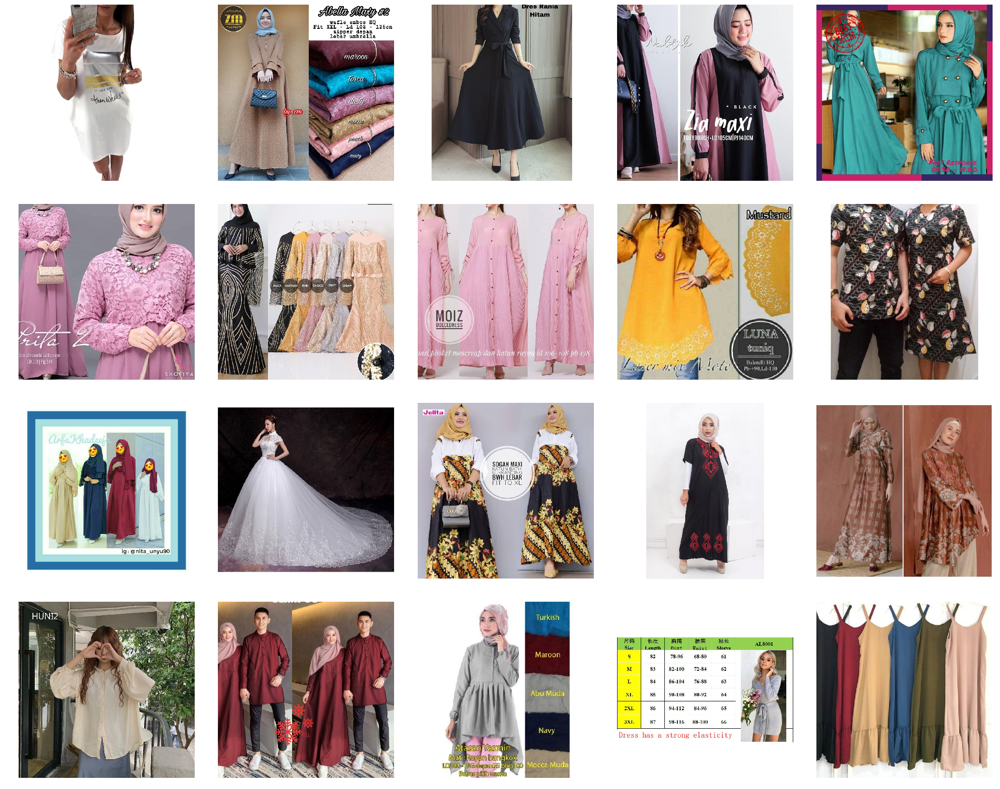

In [8]:
plot_samples(image_files, 1, 20);

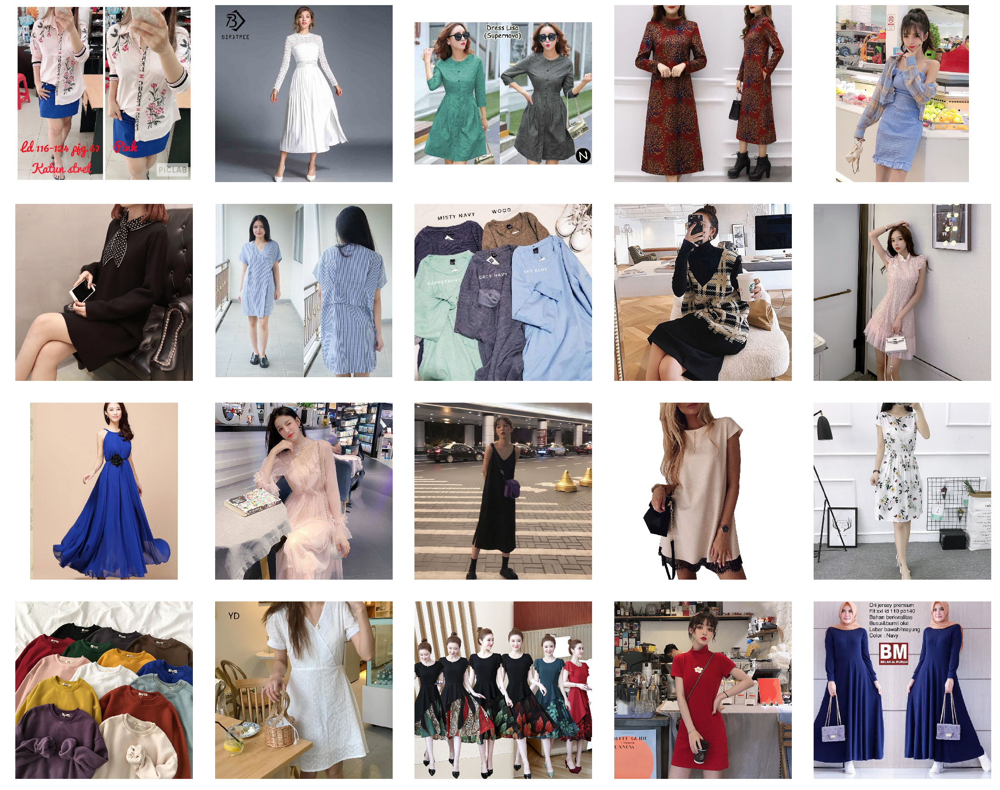

In [9]:
plot_samples(image_files, 0, 20);

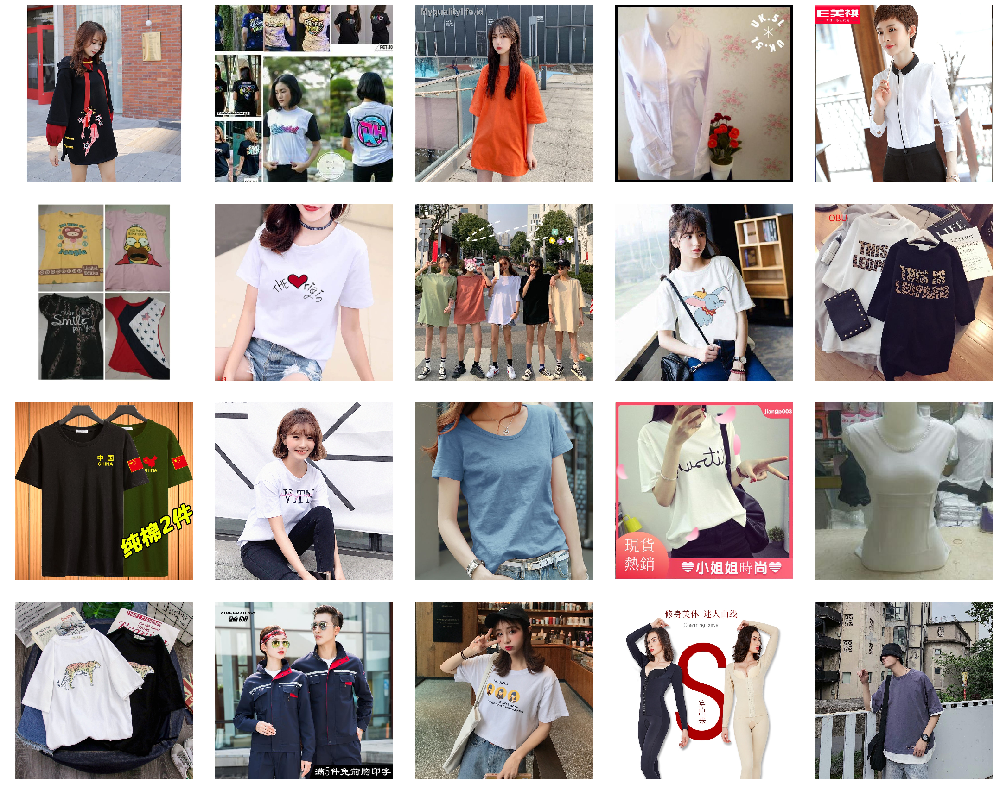

In [10]:
plot_samples(image_files, 2, 20);

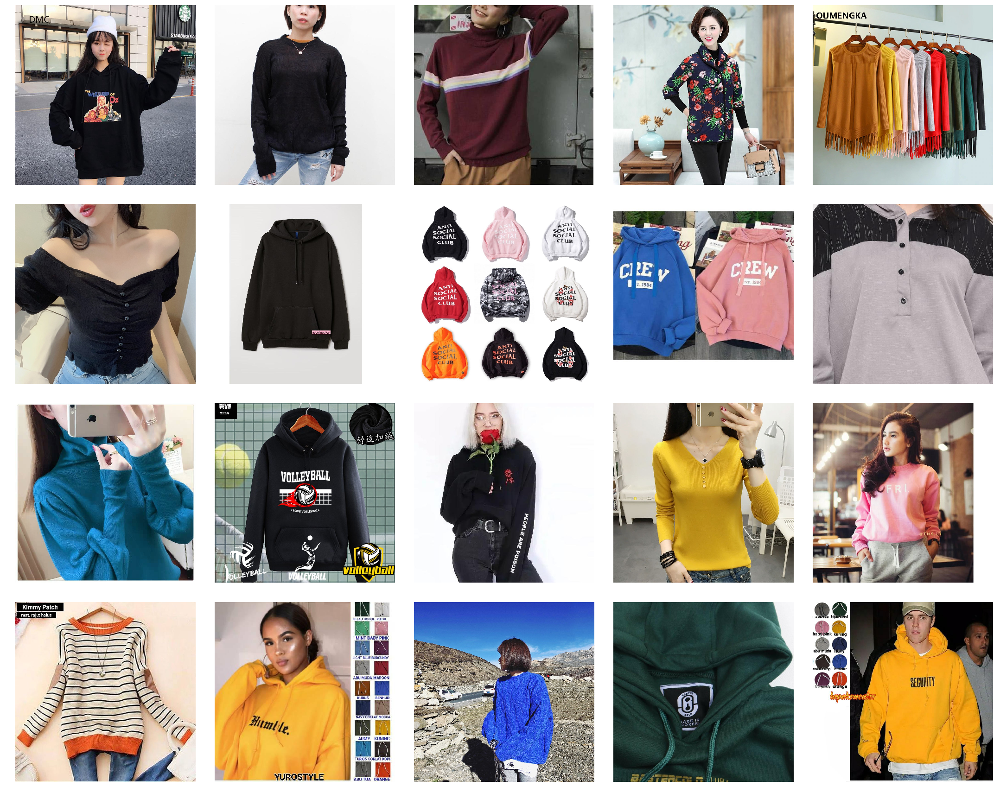

In [11]:
plot_samples(image_files, 3, 20);

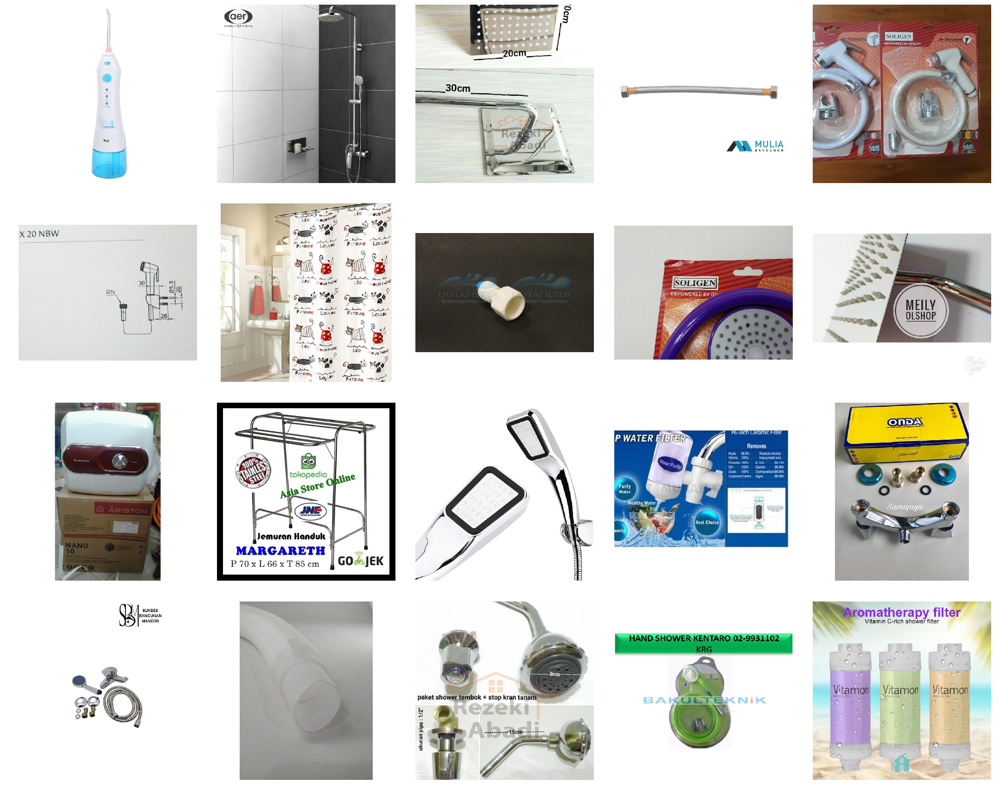

In [12]:
plot_samples(image_files, 40, 20);

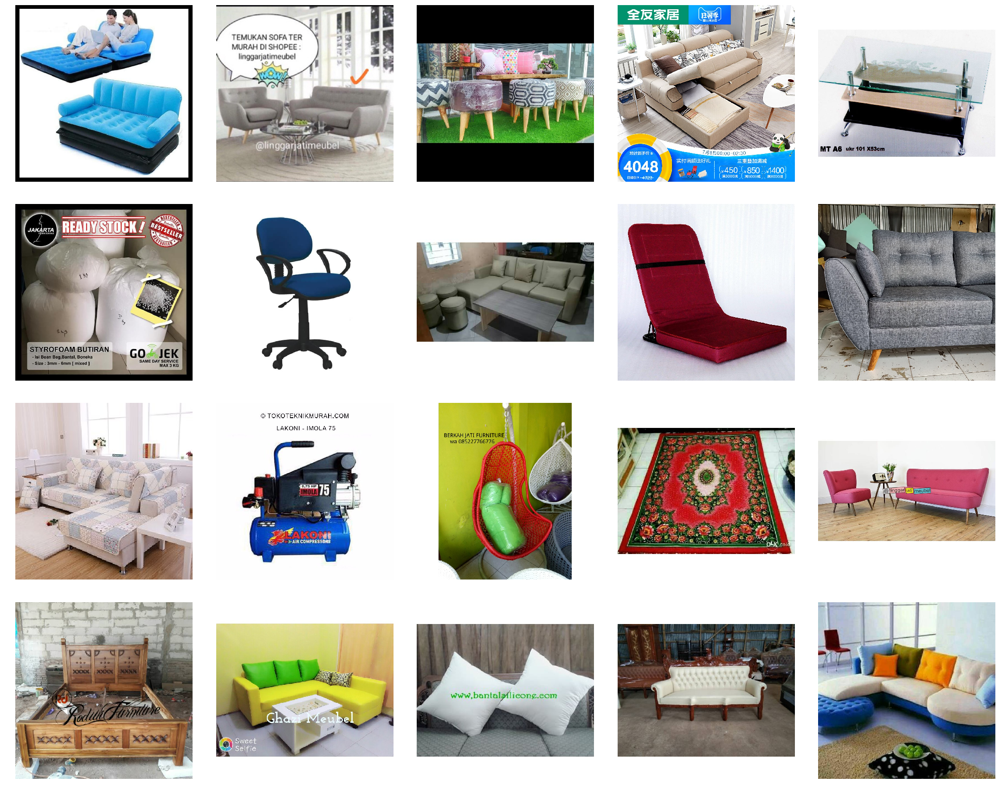

In [13]:
plot_samples(image_files, 41, 20);

## Plot Test Data

In [14]:
test_image_files = df_test.groupby('category')['filename'].apply(list).to_dict()

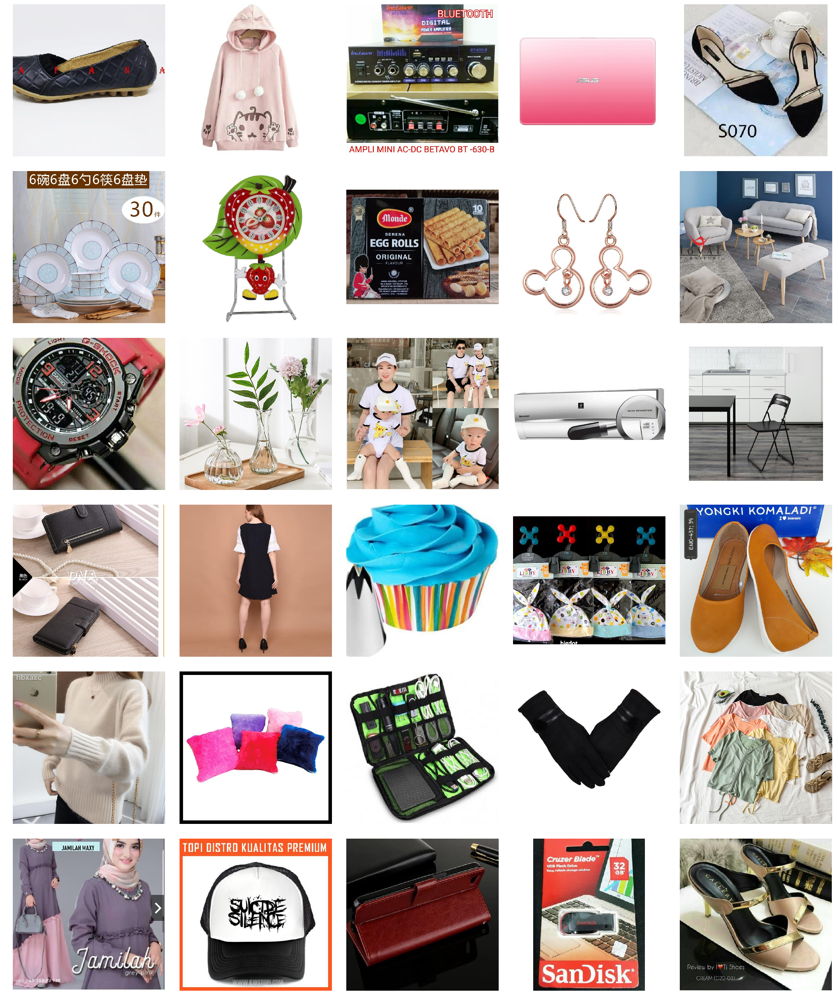

In [16]:
plot_samples(test_image_files, 43, 30, dir_='test');